In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import torch
import os
import torchvision
import gdown
import tarfile
import scipy.io
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision.utils as vutils
from torch.utils.data import Subset
from shutil import copyfile
from PIL import Image
from torchvision import datasets, transforms
from torch.utils.data import DataLoader, random_split, Dataset
import math
import tensorflow as tf
import tensorflow_datasets as tfds
import keras
from keras import layers
from keras import ops
import os

In [ ]:
celeba_images_path = '/content/celeba/img_align_celeba'
partition_file_path = '/content/celeba/list_eval_partition.txt'
flowers_images_path = '/content/flowers102/jpg'

In [ ]:
file_id = '1h_oR2jMJWO3JbIM63Oj2-2SjvnZkN3NI'
destination = 'celeba.zip'
gdown.download(f'https://drive.google.com/uc?id={file_id}', destination, quiet=False)
!unzip celeba.zip -d /content/celeba

Downloading...
From (original): https://drive.google.com/uc?id=1h_oR2jMJWO3JbIM63Oj2-2SjvnZkN3NI
From (redirected): https://drive.google.com/uc?id=1h_oR2jMJWO3JbIM63Oj2-2SjvnZkN3NI&confirm=t&uuid=48f4151b-7f86-47f0-88f4-60c2fb97de10
To: /content/celeba.zip
100%|██████████| 1.44G/1.44G [00:20<00:00, 70.3MB/s]


A streamkimeneten csak az utolsó 5000 sor látható.
 extracting: /content/celeba/img_align_celeba/197600.jpg  
 extracting: /content/celeba/img_align_celeba/197601.jpg  
 extracting: /content/celeba/img_align_celeba/197602.jpg  
 extracting: /content/celeba/img_align_celeba/197603.jpg  
 extracting: /content/celeba/img_align_celeba/197604.jpg  
 extracting: /content/celeba/img_align_celeba/197605.jpg  
 extracting: /content/celeba/img_align_celeba/197606.jpg  
 extracting: /content/celeba/img_align_celeba/197607.jpg  
 extracting: /content/celeba/img_align_celeba/197608.jpg  
 extracting: /content/celeba/img_align_celeba/197609.jpg  
 extracting: /content/celeba/img_align_celeba/197610.jpg  
 extracting: /content/celeba/img_align_celeba/197611.jpg  
 extracting: /content/celeba/img_align_celeba/197612.jpg  
 extracting: /content/celeba/img_align_celeba/197613.jpg  
 extracting: /content/celeba/img_align_celeba/197614.jpg  
 extracting: /content/celeba/img_align_celeba/197615.jpg  
 extr

In [ ]:
file_id = '1ntYY__wPA50wd_zxwIw_h-TnfvWuXrKp'
destination = '/content/celeba/list_eval_partition.txt'

gdown.download(f'https://drive.google.com/uc?id={file_id}', destination, quiet=False)

Downloading...
From: https://drive.google.com/uc?id=1ntYY__wPA50wd_zxwIw_h-TnfvWuXrKp
To: /content/celeba/list_eval_partition.txt
100%|██████████| 2.84M/2.84M [00:00<00:00, 23.0MB/s]


'/content/celeba/list_eval_partition.txt'

In [ ]:
file_id = '18-Lq0PpRpfiNHV7CozqDQUbH1iTrtnMT'
destination = 'flowers102.tgz'

gdown.download(f'https://drive.google.com/uc?id={file_id}', destination, quiet=False)
output_dir = './flowers102'
os.makedirs(output_dir, exist_ok=True)

with tarfile.open(destination) as tar:
    tar.extractall(path=output_dir)

Downloading...
From (original): https://drive.google.com/uc?id=18-Lq0PpRpfiNHV7CozqDQUbH1iTrtnMT
From (redirected): https://drive.google.com/uc?id=18-Lq0PpRpfiNHV7CozqDQUbH1iTrtnMT&confirm=t&uuid=bb926f90-92c7-4d48-9563-32451783bb99
To: /content/flowers102.tgz
100%|██████████| 345M/345M [00:02<00:00, 123MB/s]


In [ ]:
file_id = '1ekVLhSiTgDiQAj76d3JxRrepq7nZvh_L'
destination = '/content/flowers102/setid.mat'

gdown.download(f'https://drive.google.com/uc?id={file_id}', destination, quiet=False)

Downloading...
From (original): https://drive.google.com/uc?id=1ekVLhSiTgDiQAj76d3JxRrepq7nZvh_L
From (redirected): https://drive.google.com/uc?id=1ekVLhSiTgDiQAj76d3JxRrepq7nZvh_L&confirm=t&uuid=406edc03-4224-4141-8f1e-274b1cbab35e
To: /content/flowers102/setid.mat
100%|██████████| 15.0k/15.0k [00:00<00:00, 36.0MB/s]


'/content/flowers102/setid.mat'

In [ ]:
mat = scipy.io.loadmat('/content/flowers102/setid.mat')

print(mat.keys())

train_ids = mat['trnid'].flatten()
valid_ids = mat['valid'].flatten()
test_ids = mat['tstid'].flatten()

print("Training set IDs:", train_ids)
print("Validation set IDs:", valid_ids)
print("Testing set IDs:", test_ids)

dict_keys(['__header__', '__version__', '__globals__', 'trnid', 'valid', 'tstid'])
Training set IDs: [6765 6755 6768 ... 8026 8036 8041]
Validation set IDs: [6773 6767 6739 ... 8028 8008 8030]
Testing set IDs: [6734 6735 6737 ... 8044 8045 8047]


In [ ]:
os.makedirs('/content/flowers102/train', exist_ok=True)
os.makedirs('/content/flowers102/val', exist_ok=True)
os.makedirs('/content/flowers102/test', exist_ok=True)

def copy_images(set_ids, source_folder, target_folder):
    for img_id in set_ids:

        file_name = f'image_{img_id:05d}.jpg'

        source_path = os.path.join(source_folder, file_name)
        target_path = os.path.join(target_folder, file_name)

        if os.path.exists(source_path):
            copyfile(source_path, target_path)
        else:
            print(f"File not found: {source_path}")

copy_images(train_ids, flowers_images_path, '/content/flowers102/train')
copy_images(valid_ids, flowers_images_path, '/content/flowers102/val')
copy_images(test_ids, flowers_images_path, '/content/flowers102/test')

print("Images have been successfully split!")

Images have been successfully split!


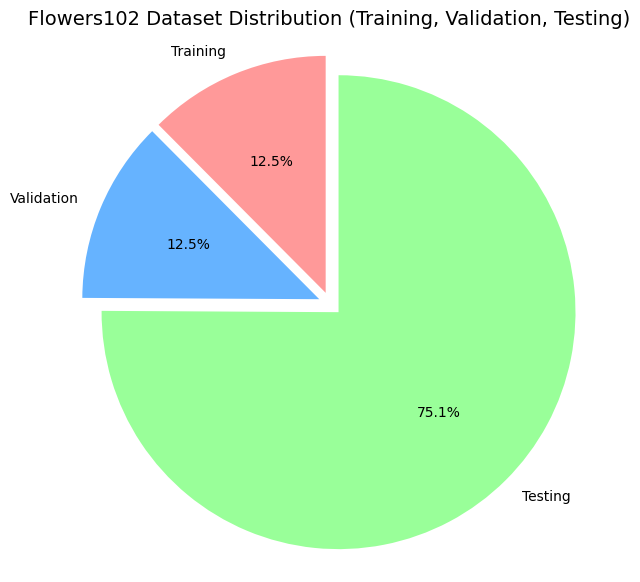

In [ ]:
train_size = len(train_ids)
valid_size = len(valid_ids)
test_size = len(test_ids)

sizes = [train_size, valid_size, test_size]
labels = ['Training', 'Validation', 'Testing']
colors = ['#ff9999','#66b3ff','#99ff99']

plt.figure(figsize=(7, 7))
plt.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=90, colors=colors, explode=(0.05, 0.05, 0.05))

plt.axis('equal')

plt.title('Flowers102 Dataset Distribution (Training, Validation, Testing)', fontsize=14)

plt.show()

In [ ]:
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

In [ ]:
celeba_data = datasets.ImageFolder(root='/content/celeba', transform=transform)
celeba_loader = DataLoader(celeba_data, batch_size=64, shuffle=True)

flowers_data = datasets.ImageFolder(root='/content/flowers102', transform=transform)
flowers_loader = DataLoader(flowers_data, batch_size=64, shuffle=True)

In [ ]:
celeba_data_iter = iter(celeba_loader)
images, labels = next(celeba_data_iter)
print(images.shape)

flowers_data_iter = iter(flowers_loader)
images, labels = next(flowers_data_iter)
print(images.shape)

torch.Size([64, 3, 64, 64])
torch.Size([64, 3, 64, 64])


In [ ]:
partition_dict = {}
with open(partition_file_path, 'r') as file:
    for line in file.readlines():
        image_name, partition = line.strip().split()
        partition_dict[image_name] = int(partition)

In [ ]:
class CelebADataset(Dataset):
    def __init__(self, root_dir, partition_dict, partition, transform=None):
        self.root_dir = root_dir
        self.partition_dict = partition_dict
        self.partition = partition
        self.transform = transform

        self.image_names = [img for img, p in partition_dict.items() if p == partition]

    def __len__(self):
        return len(self.image_names)

    def __getitem__(self, idx):
        img_name = os.path.join(self.root_dir, self.image_names[idx])
        image = Image.open(img_name)

        if self.transform:
            image = self.transform(image)

        label = self.partition_dict[self.image_names[idx]]

        return image, label

In [ ]:
celeba_train_dataset = CelebADataset(root_dir=celeba_images_path, partition_dict=partition_dict, partition=0, transform=transform)
celeba_val_dataset = CelebADataset(root_dir=celeba_images_path, partition_dict=partition_dict, partition=1, transform=transform)
celeba_test_dataset = CelebADataset(root_dir=celeba_images_path, partition_dict=partition_dict, partition=2, transform=transform)

In [ ]:
print(f'Train dataset size: {len(celeba_train_dataset)}')
print(f'Validation dataset size: {len(celeba_val_dataset)}')
print(f'Test dataset size: {len(celeba_test_dataset)}')

Train dataset size: 162770
Validation dataset size: 19867
Test dataset size: 19962


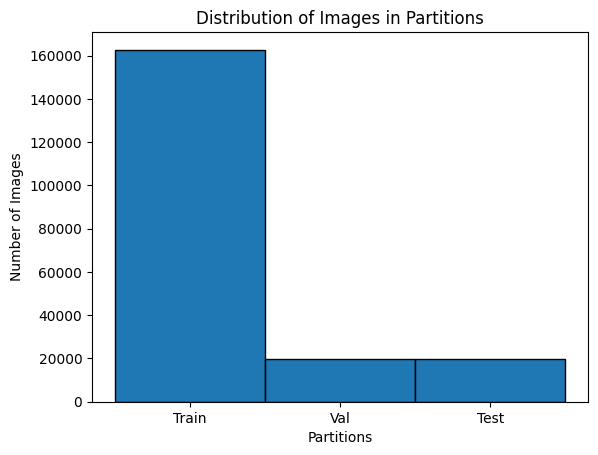

In [ ]:
partitions = list(partition_dict.values())
plt.hist(partitions, bins=[-0.5, 0.5, 1.5, 2.5], edgecolor='black')
plt.xticks([0, 1, 2], ['Train', 'Val', 'Test'])
plt.xlabel('Partitions')
plt.ylabel('Number of Images')
plt.title('Distribution of Images in Partitions')
plt.show()

In [ ]:
def check_image_validity(image_path):
    try:
        with Image.open(image_path) as img:
            img.verify()
        return True
    except (IOError, SyntaxError):
        return False

invalid_images = [img for img in os.listdir(celeba_images_path) if not check_image_validity(os.path.join(celeba_images_path, img))]
print(f'Invalid CelebA images: {len(invalid_images)}')


Invalid CelebA images: 0


In [ ]:
celeba_train_loader = DataLoader(celeba_train_dataset, batch_size=64, shuffle=True)
celeba_val_loader = DataLoader(celeba_val_dataset, batch_size=64, shuffle=False)
celeba_test_loader = DataLoader(celeba_test_dataset, batch_size=64, shuffle=False)

In [ ]:
data_iter = iter(celeba_train_loader)
images, labels = next(data_iter)

print(f'Images batch shape: {images.shape}')
print(f'Labels batch shape: {labels.shape}')

Images batch shape: torch.Size([64, 3, 64, 64])
Labels batch shape: torch.Size([64])


In [ ]:
class SimpleCNN(nn.Module):
    def __init__(self, num_classes=2):
        super(SimpleCNN, self).__init__()

        self.conv1 = nn.Conv2d(3, 32, kernel_size=3, stride=1, padding=1)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1)
        self.conv3 = nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1)

        self.pool = nn.MaxPool2d(kernel_size=2, stride=2, padding=0)

        self.fc1 = nn.Linear(128 * 8 * 8, 256)
        self.fc2 = nn.Linear(256, num_classes)

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        x = self.pool(F.relu(self.conv3(x)))

        x = x.view(-1, 128 * 8 * 8)
        x = F.relu(self.fc1(x))
        x = self.fc2(x)

        return x

In [ ]:
num_classes = 2
model = SimpleCNN(num_classes=num_classes)

criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

In [ ]:
num_epochs = 2
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

for epoch in range(num_epochs):
    running_loss = 0.0
    for images, labels in celeba_train_loader:
        images, labels = images.to(device), labels.to(device)

        optimizer.zero_grad()

        outputs = model(images)
        loss = criterion(outputs, labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {running_loss/len(celeba_train_loader):.4f}')

Epoch [1/2], Loss: 0.0003
Epoch [2/2], Loss: 0.0000


In [ ]:
model.eval()

correct = 0
total = 0
with torch.no_grad():
    for images, labels in celeba_test_loader:
        images, labels = images.to(device), labels.to(device)
        outputs = model(images)
        _, predicted = torch.max(outputs, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

print(f'Teszt adathalmazon elért pontosság: {100 * correct / total:.2f}%')

Teszt adathalmazon elért pontosság: 0.00%


In [ ]:
train_size = 10000
val_size = 2000
test_size = 2000

train_indices = torch.randperm(len(celeba_train_dataset))[:train_size]
val_indices = torch.randperm(len(celeba_val_dataset))[:val_size]
test_indices = torch.randperm(len(celeba_test_dataset))[:test_size]

small_train_dataset = Subset(celeba_train_dataset, train_indices)
small_val_dataset = Subset(celeba_val_dataset, val_indices)
small_test_dataset = Subset(celeba_test_dataset, test_indices)

small_train_loader = DataLoader(small_train_dataset, batch_size=64, shuffle=True)
small_val_loader = DataLoader(small_val_dataset, batch_size=64, shuffle=False)
small_test_loader = DataLoader(small_test_dataset, batch_size=64, shuffle=False)

print(f'Csökkentett train dataset méret: {len(small_train_dataset)}')
print(f'Csökkentett validation dataset méret: {len(small_val_dataset)}')
print(f'Csökkentett test dataset méret: {len(small_test_dataset)}')

Csökkentett train dataset méret: 10000
Csökkentett validation dataset méret: 2000
Csökkentett test dataset méret: 2000


In [ ]:
class Generator(nn.Module):
    def __init__(self, latent_dim=64):
        super(Generator, self).__init__()
        self.fc1 = nn.Linear(latent_dim, 128)
        self.fc2 = nn.Linear(128, 64 * 64 * 3)

    def forward(self, z):
        x = torch.relu(self.fc1(z))
        x = torch.tanh(self.fc2(x))
        x = x.view(-1, 3, 64, 64)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.fc1 = nn.Linear(64 * 64 * 3, 128)
        self.fc2 = nn.Linear(128, 1)

    def forward(self, x):
        x = x.view(x.size(0), -1)
        h = torch.relu(self.fc1(x))
        return torch.sigmoid(self.fc2(h))


In [ ]:
latent_dim = 100
lr = 0.0002
num_epochs = 5

generator = Generator(latent_dim)
discriminator = Discriminator()

optimizer_G = optim.Adam(generator.parameters(), lr=lr)
optimizer_D = optim.Adam(discriminator.parameters(), lr=lr)

criterion = nn.BCELoss()

for epoch in range(num_epochs):
    for real_images, _ in celeba_train_loader:

        optimizer_D.zero_grad()
        real_labels = torch.ones(real_images.size(0), 1)
        fake_labels = torch.zeros(real_images.size(0), 1)

        outputs = discriminator(real_images)
        d_loss_real = criterion(outputs, real_labels)

        z = torch.randn(real_images.size(0), latent_dim)
        fake_images = generator(z)
        outputs = discriminator(fake_images.detach())
        d_loss_fake = criterion(outputs, fake_labels)

        d_loss = d_loss_real + d_loss_fake
        d_loss.backward()
        optimizer_D.step()

        optimizer_G.zero_grad()
        z = torch.randn(real_images.size(0), latent_dim)
        fake_images = generator(z)
        outputs = discriminator(fake_images)
        g_loss = criterion(outputs, real_labels)
        g_loss.backward()
        optimizer_G.step()

    print(f"Epoch [{epoch+1}/{num_epochs}], d_loss: {d_loss.item()}, g_loss: {g_loss.item()}")

Epoch [1/5], d_loss: 0.04225189983844757, g_loss: 4.04817008972168
Epoch [2/5], d_loss: 0.026150617748498917, g_loss: 4.948101997375488
Epoch [3/5], d_loss: 0.14114192128181458, g_loss: 6.256589889526367
Epoch [4/5], d_loss: 0.14792871475219727, g_loss: 5.44174861907959
Epoch [5/5], d_loss: 0.12794612348079681, g_loss: 4.453214168548584


In [ ]:
z = torch.randn(64, latent_dim)
fake_images = generator(z)

plt.figure(figsize=(8, 8))
plt.axis("off")
plt.imshow(np.transpose(vutils.make_grid(fake_images, padding=2, normalize=True).cpu(), (1, 2, 0)))
plt.show()

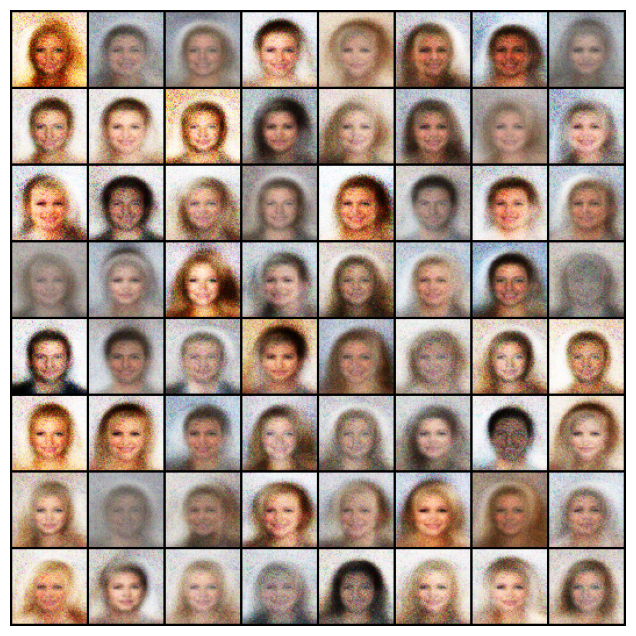

In [ ]:
z = torch.randn(64, latent_dim)
fake_images = generator(z)

plt.figure(figsize=(8, 8))
plt.axis("off")
plt.imshow(np.transpose(vutils.make_grid(fake_images, padding=2, normalize=True).cpu(), (1, 2, 0)))
plt.show()

In [ ]:
os.environ["KERAS_BACKEND"] = "tensorflow"

In [ ]:
dataset_name = "oxford_flowers102"
dataset_repetitions = 5
num_epochs = 20
image_size = 64

kid_image_size = 75
kid_diffusion_steps = 5
plot_diffusion_steps = 20

min_signal_rate = 0.02
max_signal_rate = 0.95

embedding_dims = 32
embedding_max_frequency = 1000.0
widths = [32, 64, 96, 128]
block_depth = 2

batch_size = 64
ema = 0.999
learning_rate = 1e-3
weight_decay = 1e-4

In [ ]:
def preprocess_image(data):

    height = ops.shape(data["image"])[0]
    width = ops.shape(data["image"])[1]
    crop_size = ops.minimum(height, width)
    image = tf.image.crop_to_bounding_box(
        data["image"],
        (height - crop_size) // 2,
        (width - crop_size) // 2,
        crop_size,
        crop_size,
    )


    image = tf.image.resize(image, size=[image_size, image_size], antialias=True)
    return ops.clip(image / 255.0, 0.0, 1.0)


def prepare_dataset(split):

    return (
        tfds.load(dataset_name, split=split, shuffle_files=True)
        .map(preprocess_image, num_parallel_calls=tf.data.AUTOTUNE)
        .cache()
        .repeat(dataset_repetitions)
        .shuffle(10 * batch_size)
        .batch(batch_size, drop_remainder=True)
        .prefetch(buffer_size=tf.data.AUTOTUNE)
    )


train_dataset = prepare_dataset("train[:80%]+validation[:80%]+test[:80%]")
val_dataset = prepare_dataset("train[80%:]+validation[80%:]+test[80%:]")

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

In [ ]:
@keras.saving.register_keras_serializable()
class KID(keras.metrics.Metric):
    def __init__(self, name, **kwargs):
        super().__init__(name=name, **kwargs)

        self.kid_tracker = keras.metrics.Mean(name="kid_tracker")

        self.encoder = keras.Sequential(
            [
                keras.Input(shape=(image_size, image_size, 3)),
                layers.Rescaling(255.0),
                layers.Resizing(height=kid_image_size, width=kid_image_size),
                layers.Lambda(keras.applications.inception_v3.preprocess_input),
                keras.applications.InceptionV3(
                    include_top=False,
                    input_shape=(kid_image_size, kid_image_size, 3),
                    weights="imagenet",
                ),
                layers.GlobalAveragePooling2D(),
            ],
            name="inception_encoder",
        )

    def polynomial_kernel(self, features_1, features_2):
        feature_dimensions = ops.cast(ops.shape(features_1)[1], dtype="float32")
        return (
            features_1 @ ops.transpose(features_2) / feature_dimensions + 1.0
        ) ** 3.0

    def update_state(self, real_images, generated_images, sample_weight=None):
        real_features = self.encoder(real_images, training=False)
        generated_features = self.encoder(generated_images, training=False)

        kernel_real = self.polynomial_kernel(real_features, real_features)
        kernel_generated = self.polynomial_kernel(
            generated_features, generated_features
        )
        kernel_cross = self.polynomial_kernel(real_features, generated_features)

        batch_size = real_features.shape[0]
        batch_size_f = ops.cast(batch_size, dtype="float32")
        mean_kernel_real = ops.sum(kernel_real * (1.0 - ops.eye(batch_size))) / (
            batch_size_f * (batch_size_f - 1.0)
        )
        mean_kernel_generated = ops.sum(
            kernel_generated * (1.0 - ops.eye(batch_size))
        ) / (batch_size_f * (batch_size_f - 1.0))
        mean_kernel_cross = ops.mean(kernel_cross)
        kid = mean_kernel_real + mean_kernel_generated - 2.0 * mean_kernel_cross

        self.kid_tracker.update_state(kid)

    def result(self):
        return self.kid_tracker.result()

    def reset_state(self):
        self.kid_tracker.reset_state()


In [ ]:

@keras.saving.register_keras_serializable()
def sinusoidal_embedding(x):
    embedding_min_frequency = 1.0
    frequencies = ops.exp(
        ops.linspace(
            ops.log(embedding_min_frequency),
            ops.log(embedding_max_frequency),
            embedding_dims // 2,
        )
    )
    angular_speeds = ops.cast(2.0 * math.pi * frequencies, "float32")
    embeddings = ops.concatenate(
        [ops.sin(angular_speeds * x), ops.cos(angular_speeds * x)], axis=3
    )
    return embeddings


def ResidualBlock(width):
    def apply(x):
        input_width = x.shape[3]
        if input_width == width:
            residual = x
        else:
            residual = layers.Conv2D(width, kernel_size=1)(x)
        x = layers.BatchNormalization(center=False, scale=False)(x)
        x = layers.Conv2D(width, kernel_size=3, padding="same", activation="swish")(x)
        x = layers.Conv2D(width, kernel_size=3, padding="same")(x)
        x = layers.Add()([x, residual])
        return x

    return apply


def DownBlock(width, block_depth):
    def apply(x):
        x, skips = x
        for _ in range(block_depth):
            x = ResidualBlock(width)(x)
            skips.append(x)
        x = layers.AveragePooling2D(pool_size=2)(x)
        return x

    return apply


def UpBlock(width, block_depth):
    def apply(x):
        x, skips = x
        x = layers.UpSampling2D(size=2, interpolation="bilinear")(x)
        for _ in range(block_depth):
            x = layers.Concatenate()([x, skips.pop()])
            x = ResidualBlock(width)(x)
        return x

    return apply


def get_network(image_size, widths, block_depth):
    noisy_images = keras.Input(shape=(image_size, image_size, 3))
    noise_variances = keras.Input(shape=(1, 1, 1))

    e = layers.Lambda(sinusoidal_embedding, output_shape=(1, 1, 32))(noise_variances)
    e = layers.UpSampling2D(size=image_size, interpolation="nearest")(e)

    x = layers.Conv2D(widths[0], kernel_size=1)(noisy_images)
    x = layers.Concatenate()([x, e])

    skips = []
    for width in widths[:-1]:
        x = DownBlock(width, block_depth)([x, skips])

    for _ in range(block_depth):
        x = ResidualBlock(widths[-1])(x)

    for width in reversed(widths[:-1]):
        x = UpBlock(width, block_depth)([x, skips])

    x = layers.Conv2D(3, kernel_size=1, kernel_initializer="zeros")(x)

    return keras.Model([noisy_images, noise_variances], x, name="residual_unet")


In [ ]:

@keras.saving.register_keras_serializable()
class DiffusionModel(keras.Model):
    def __init__(self, image_size, widths, block_depth):
        super().__init__()

        self.normalizer = layers.Normalization()
        self.network = get_network(image_size, widths, block_depth)
        self.ema_network = keras.models.clone_model(self.network)

    def compile(self, **kwargs):
        super().compile(**kwargs)

        self.noise_loss_tracker = keras.metrics.Mean(name="n_loss")
        self.image_loss_tracker = keras.metrics.Mean(name="i_loss")
        self.kid = KID(name="kid")

    @property
    def metrics(self):
        return [self.noise_loss_tracker, self.image_loss_tracker, self.kid]

    def denormalize(self, images):
        images = self.normalizer.mean + images * self.normalizer.variance**0.5
        return ops.clip(images, 0.0, 1.0)

    def diffusion_schedule(self, diffusion_times):
        start_angle = ops.cast(ops.arccos(max_signal_rate), "float32")
        end_angle = ops.cast(ops.arccos(min_signal_rate), "float32")

        diffusion_angles = start_angle + diffusion_times * (end_angle - start_angle)

        signal_rates = ops.cos(diffusion_angles)
        noise_rates = ops.sin(diffusion_angles)

        return noise_rates, signal_rates

    def denoise(self, noisy_images, noise_rates, signal_rates, training):
        if training:
            network = self.network
        else:
            network = self.ema_network

        pred_noises = network([noisy_images, noise_rates**2], training=training)
        pred_images = (noisy_images - noise_rates * pred_noises) / signal_rates

        return pred_noises, pred_images

    def reverse_diffusion(self, initial_noise, diffusion_steps):
        num_images = initial_noise.shape[0]
        step_size = 1.0 / diffusion_steps

        next_noisy_images = initial_noise
        for step in range(diffusion_steps):
            noisy_images = next_noisy_images

            diffusion_times = ops.ones((num_images, 1, 1, 1)) - step * step_size
            noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
            pred_noises, pred_images = self.denoise(
                noisy_images, noise_rates, signal_rates, training=False
            )

            next_diffusion_times = diffusion_times - step_size
            next_noise_rates, next_signal_rates = self.diffusion_schedule(
                next_diffusion_times
            )
            next_noisy_images = (
                next_signal_rates * pred_images + next_noise_rates * pred_noises
            )

        return pred_images

    def generate(self, num_images, diffusion_steps):
        initial_noise = keras.random.normal(
            shape=(num_images, image_size, image_size, 3)
        )
        generated_images = self.reverse_diffusion(initial_noise, diffusion_steps)
        generated_images = self.denormalize(generated_images)
        return generated_images

    def train_step(self, images):
        images = self.normalizer(images, training=True)
        noises = keras.random.normal(shape=(batch_size, image_size, image_size, 3))

        diffusion_times = keras.random.uniform(
            shape=(batch_size, 1, 1, 1), minval=0.0, maxval=1.0
        )
        noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
        noisy_images = signal_rates * images + noise_rates * noises

        with tf.GradientTape() as tape:
            pred_noises, pred_images = self.denoise(
                noisy_images, noise_rates, signal_rates, training=True
            )

            noise_loss = self.loss(noises, pred_noises)
            image_loss = self.loss(images, pred_images)

        gradients = tape.gradient(noise_loss, self.network.trainable_weights)
        self.optimizer.apply_gradients(zip(gradients, self.network.trainable_weights))

        self.noise_loss_tracker.update_state(noise_loss)
        self.image_loss_tracker.update_state(image_loss)

        for weight, ema_weight in zip(self.network.weights, self.ema_network.weights):
            ema_weight.assign(ema * ema_weight + (1 - ema) * weight)

        return {m.name: m.result() for m in self.metrics[:-1]}

    def test_step(self, images):
        images = self.normalizer(images, training=False)
        noises = keras.random.normal(shape=(batch_size, image_size, image_size, 3))

        diffusion_times = keras.random.uniform(
            shape=(batch_size, 1, 1, 1), minval=0.0, maxval=1.0
        )
        noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
        noisy_images = signal_rates * images + noise_rates * noises

        pred_noises, pred_images = self.denoise(
            noisy_images, noise_rates, signal_rates, training=False
        )

        noise_loss = self.loss(noises, pred_noises)
        image_loss = self.loss(images, pred_images)

        self.image_loss_tracker.update_state(image_loss)
        self.noise_loss_tracker.update_state(noise_loss)

        images = self.denormalize(images)
        generated_images = self.generate(
            num_images=batch_size, diffusion_steps=kid_diffusion_steps
        )
        self.kid.update_state(images, generated_images)

        return {m.name: m.result() for m in self.metrics}

    def plot_images(self, epoch=None, logs=None, num_rows=3, num_cols=6):
        generated_images = self.generate(
            num_images=num_rows * num_cols,
            diffusion_steps=plot_diffusion_steps,
        )

        plt.figure(figsize=(num_cols * 2.0, num_rows * 2.0))
        for row in range(num_rows):
            for col in range(num_cols):
                index = row * num_cols + col
                plt.subplot(num_rows, num_cols, index + 1)
                plt.imshow(generated_images[index])
                plt.axis("off")
        plt.tight_layout()
        plt.show()
        plt.close()


87910968/87910968 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step
Epoch 1/20
511/511 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step - i_loss: 0.6647 - n_loss: 0.2856

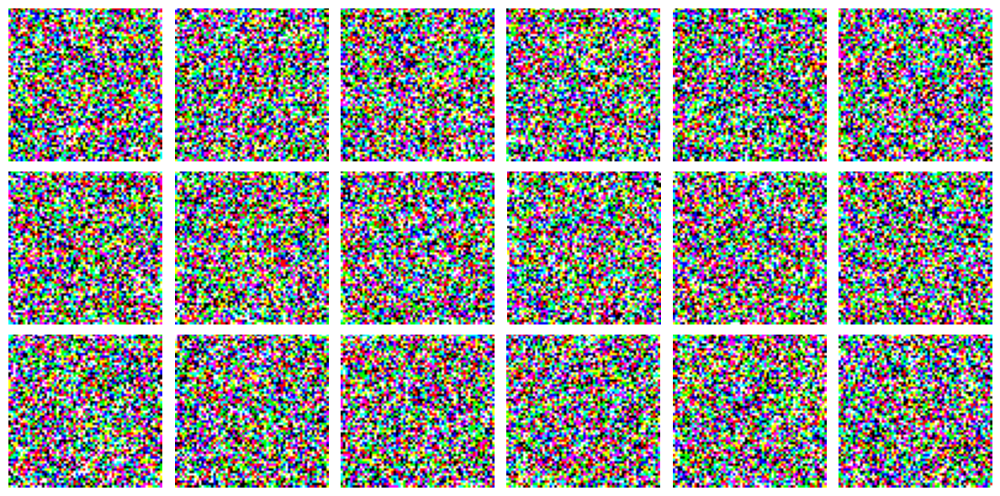

511/511 ━━━━━━━━━━━━━━━━━━━━ 187s 295ms/step - i_loss: 0.6642 - n_loss: 0.2855 - val_i_loss: 2.4425 - val_kid: 2.0441 - val_n_loss: 0.7875
Epoch 2/20
511/511 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step - i_loss: 0.2859 - n_loss: 0.1705

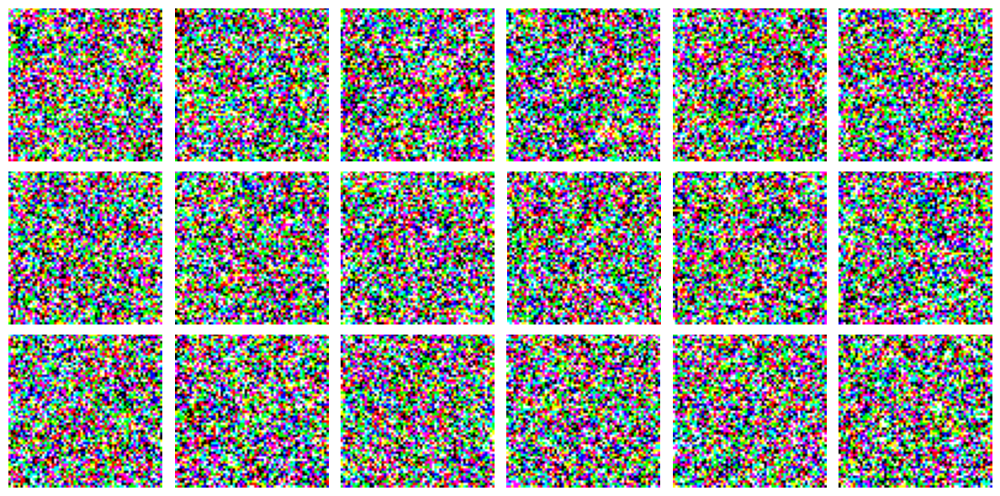

511/511 ━━━━━━━━━━━━━━━━━━━━ 157s 250ms/step - i_loss: 0.2859 - n_loss: 0.1705 - val_i_loss: 2.1883 - val_kid: 1.9071 - val_n_loss: 0.7167
Epoch 3/20
511/511 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step - i_loss: 0.2725 - n_loss: 0.1616

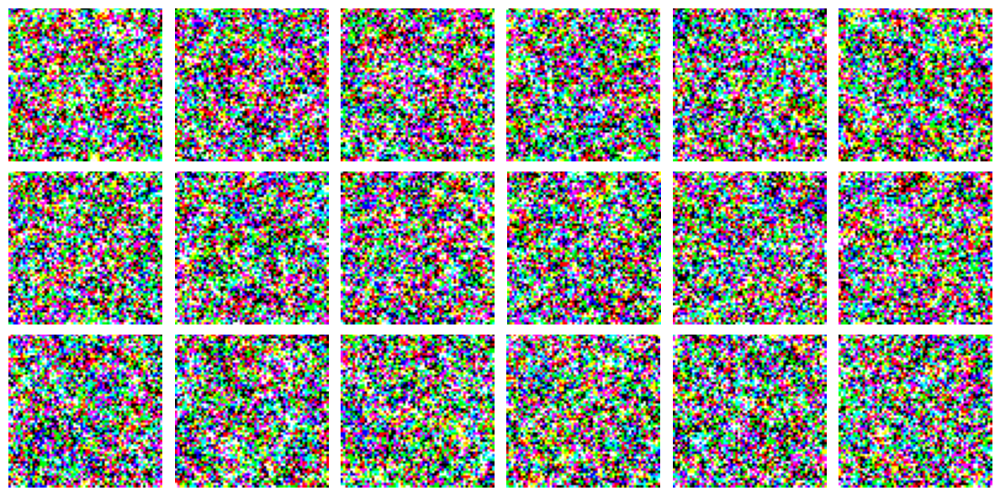

511/511 ━━━━━━━━━━━━━━━━━━━━ 130s 254ms/step - i_loss: 0.2725 - n_loss: 0.1616 - val_i_loss: 1.7345 - val_kid: 1.5948 - val_n_loss: 0.5899
Epoch 4/20
511/511 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step - i_loss: 0.2666 - n_loss: 0.1584

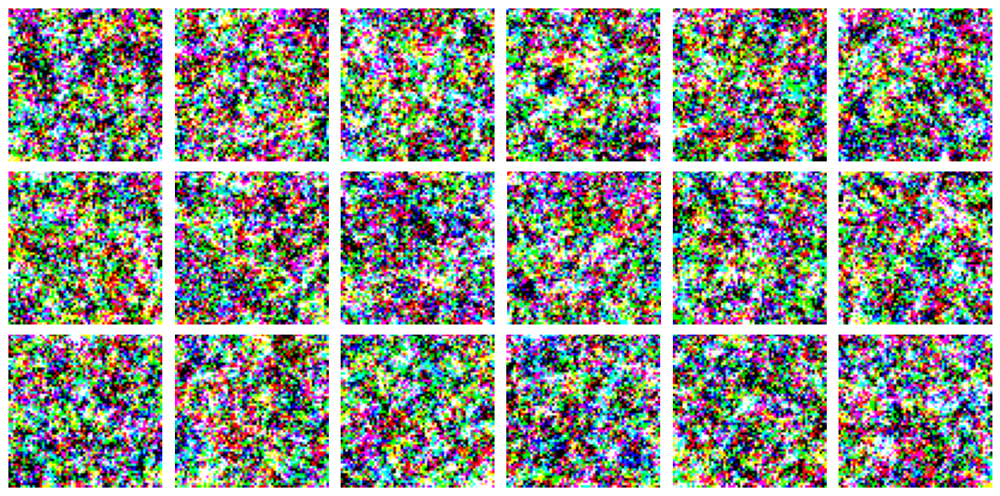

511/511 ━━━━━━━━━━━━━━━━━━━━ 142s 253ms/step - i_loss: 0.2666 - n_loss: 0.1584 - val_i_loss: 1.2552 - val_kid: 1.3639 - val_n_loss: 0.4505
Epoch 5/20
511/511 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step - i_loss: 0.2569 - n_loss: 0.1558

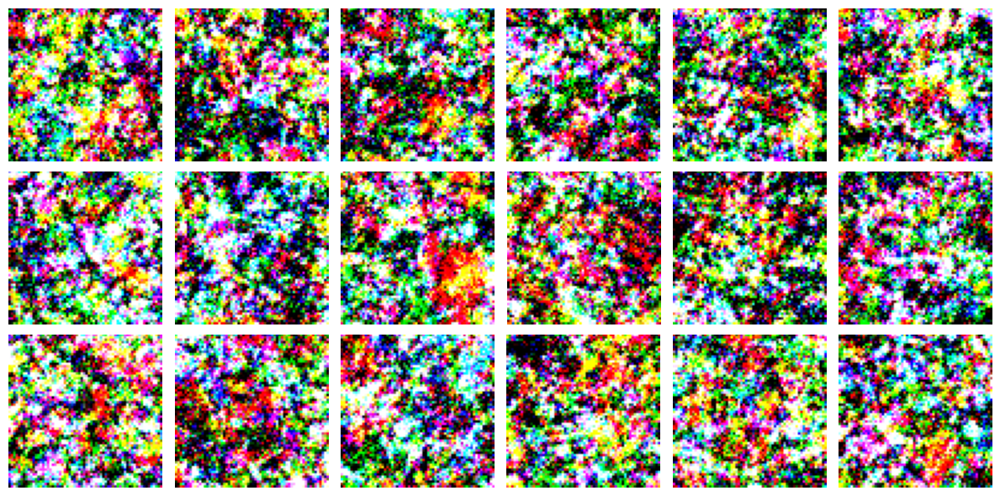

511/511 ━━━━━━━━━━━━━━━━━━━━ 182s 332ms/step - i_loss: 0.2569 - n_loss: 0.1558 - val_i_loss: 0.8980 - val_kid: 1.4450 - val_n_loss: 0.3321
Epoch 6/20
511/511 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step - i_loss: 0.2581 - n_loss: 0.1542

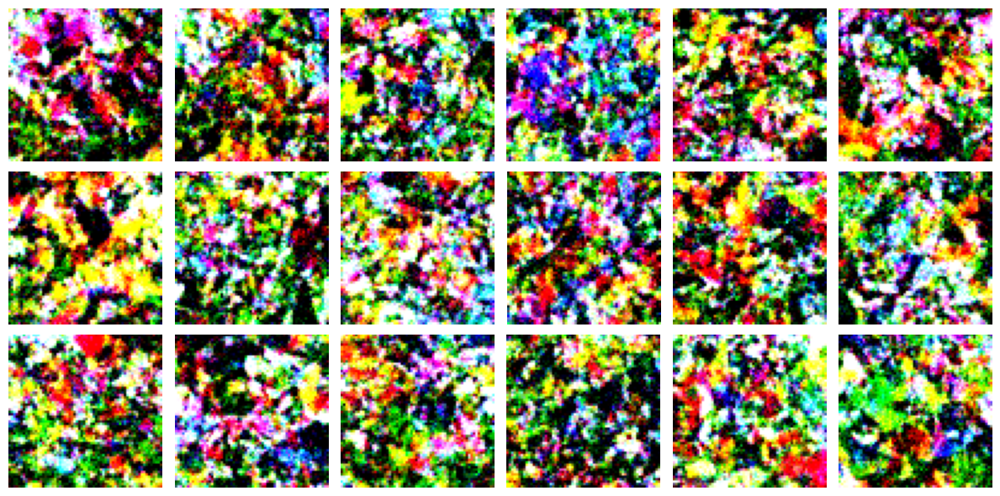

511/511 ━━━━━━━━━━━━━━━━━━━━ 160s 250ms/step - i_loss: 0.2581 - n_loss: 0.1542 - val_i_loss: 0.6326 - val_kid: 1.4622 - val_n_loss: 0.2488
Epoch 7/20
511/511 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step - i_loss: 0.2529 - n_loss: 0.1527

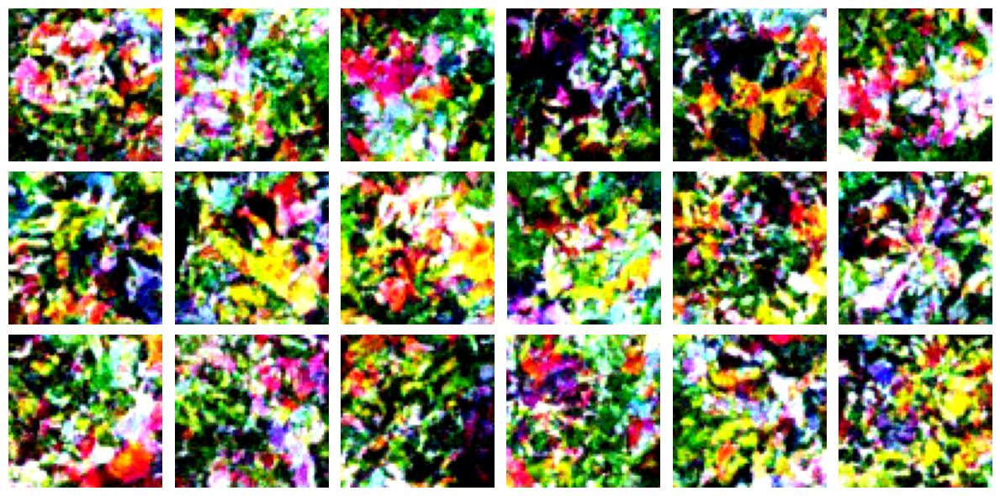

511/511 ━━━━━━━━━━━━━━━━━━━━ 144s 254ms/step - i_loss: 0.2529 - n_loss: 0.1527 - val_i_loss: 0.4456 - val_kid: 1.1331 - val_n_loss: 0.1991
Epoch 8/20
511/511 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step - i_loss: 0.2527 - n_loss: 0.1515

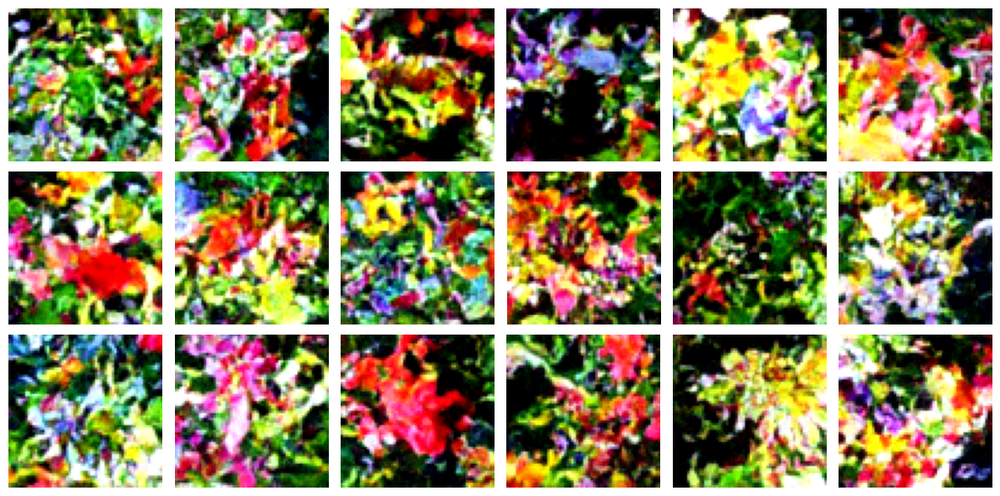

511/511 ━━━━━━━━━━━━━━━━━━━━ 142s 254ms/step - i_loss: 0.2527 - n_loss: 0.1515 - val_i_loss: 0.3450 - val_kid: 0.9500 - val_n_loss: 0.1719
Epoch 9/20
511/511 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step - i_loss: 0.2495 - n_loss: 0.1509

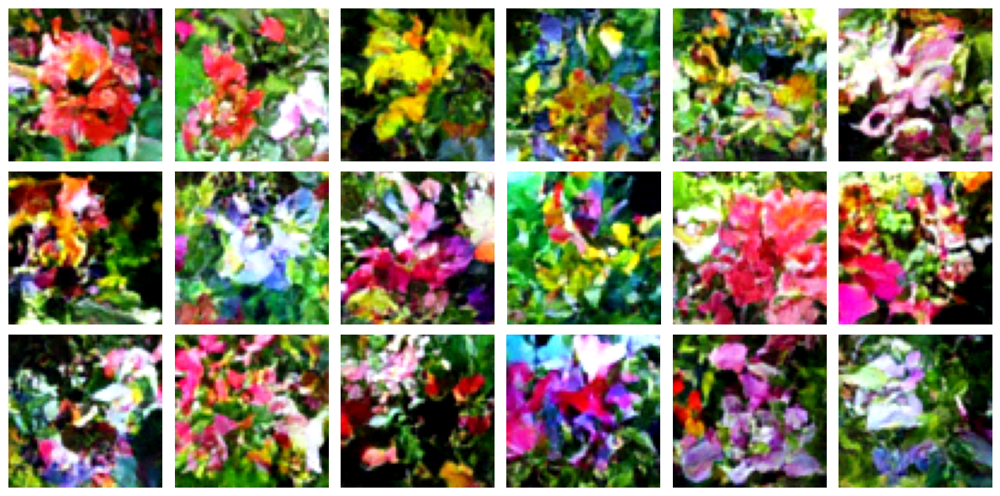

511/511 ━━━━━━━━━━━━━━━━━━━━ 143s 256ms/step - i_loss: 0.2495 - n_loss: 0.1509 - val_i_loss: 0.2835 - val_kid: 0.8745 - val_n_loss: 0.1580
Epoch 10/20
511/511 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step - i_loss: 0.2487 - n_loss: 0.1505

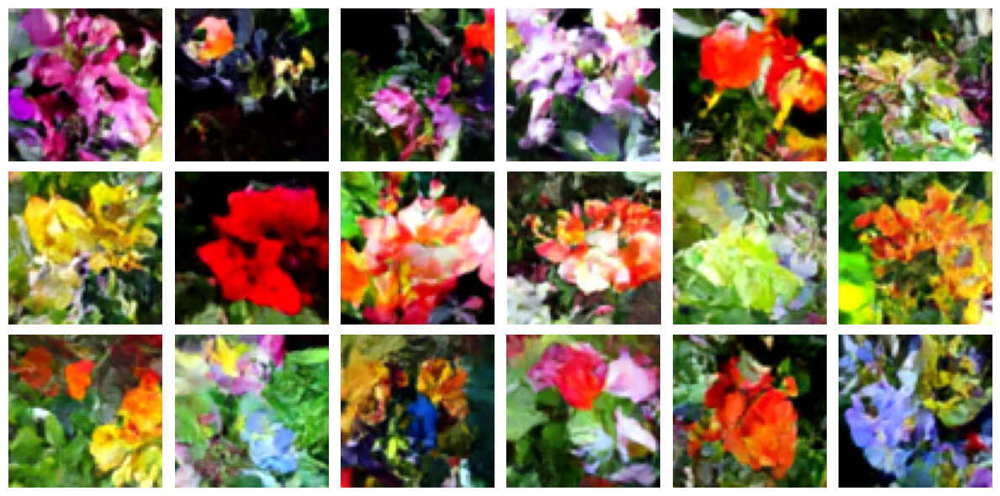

511/511 ━━━━━━━━━━━━━━━━━━━━ 141s 254ms/step - i_loss: 0.2487 - n_loss: 0.1505 - val_i_loss: 0.2620 - val_kid: 0.8009 - val_n_loss: 0.1500
Epoch 11/20
511/511 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step - i_loss: 0.2438 - n_loss: 0.1498

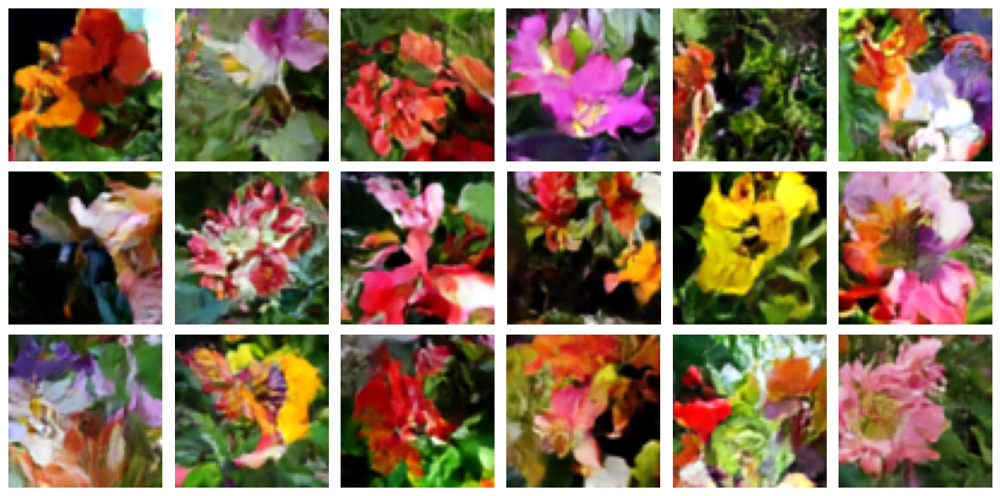

511/511 ━━━━━━━━━━━━━━━━━━━━ 143s 257ms/step - i_loss: 0.2438 - n_loss: 0.1498 - val_i_loss: 0.2431 - val_kid: 0.6870 - val_n_loss: 0.1500
Epoch 12/20
511/511 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step - i_loss: 0.2451 - n_loss: 0.1502

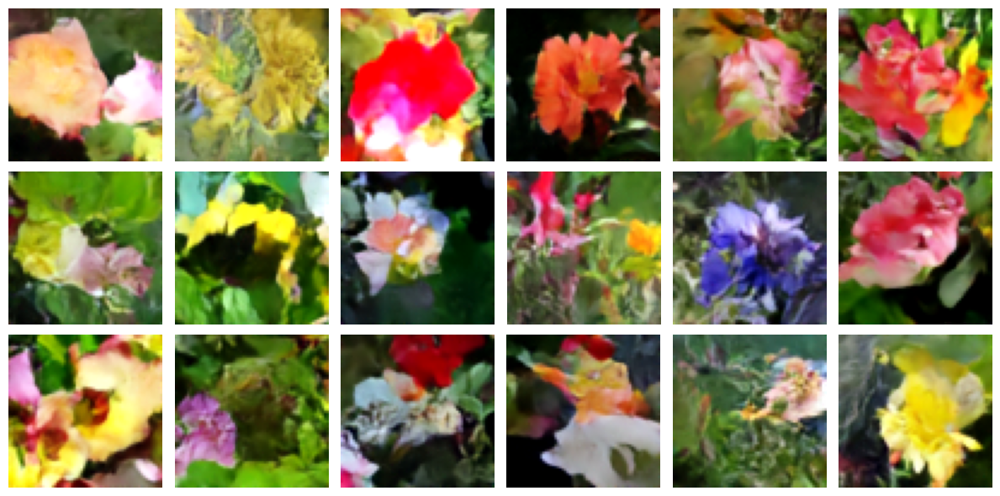

511/511 ━━━━━━━━━━━━━━━━━━━━ 132s 259ms/step - i_loss: 0.2451 - n_loss: 0.1502 - val_i_loss: 0.2388 - val_kid: 0.5323 - val_n_loss: 0.1468
Epoch 13/20
511/511 ━━━━━━━━━━━━━━━━━━━━ 0s 165ms/step - i_loss: 0.2454 - n_loss: 0.1491

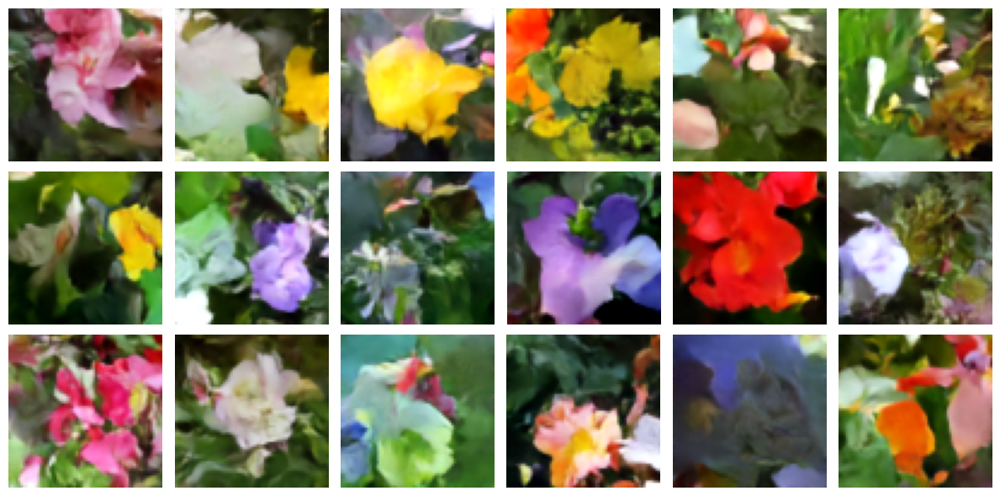

511/511 ━━━━━━━━━━━━━━━━━━━━ 180s 333ms/step - i_loss: 0.2454 - n_loss: 0.1491 - val_i_loss: 0.2342 - val_kid: 0.4228 - val_n_loss: 0.1469
Epoch 14/20
511/511 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step - i_loss: 0.2439 - n_loss: 0.1481

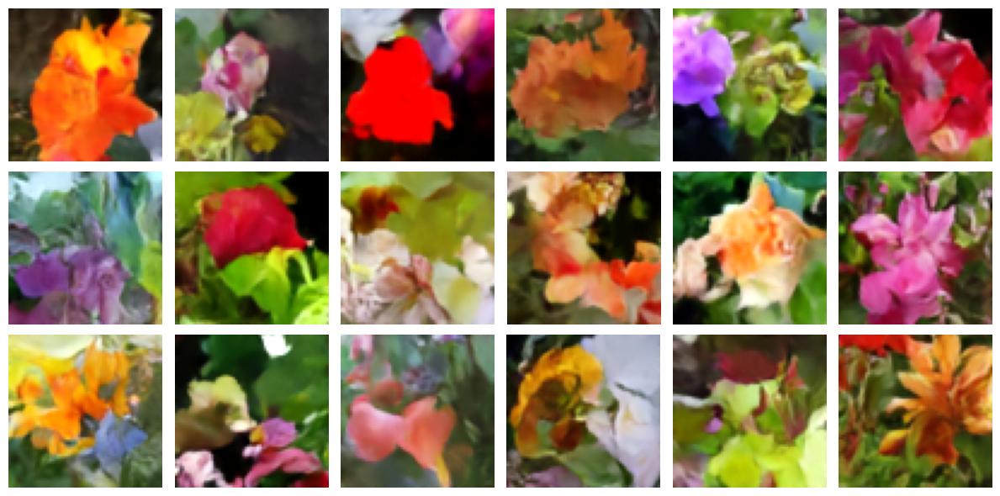

511/511 ━━━━━━━━━━━━━━━━━━━━ 169s 332ms/step - i_loss: 0.2439 - n_loss: 0.1481 - val_i_loss: 0.2310 - val_kid: 0.3476 - val_n_loss: 0.1470
Epoch 15/20
511/511 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step - i_loss: 0.2416 - n_loss: 0.1496

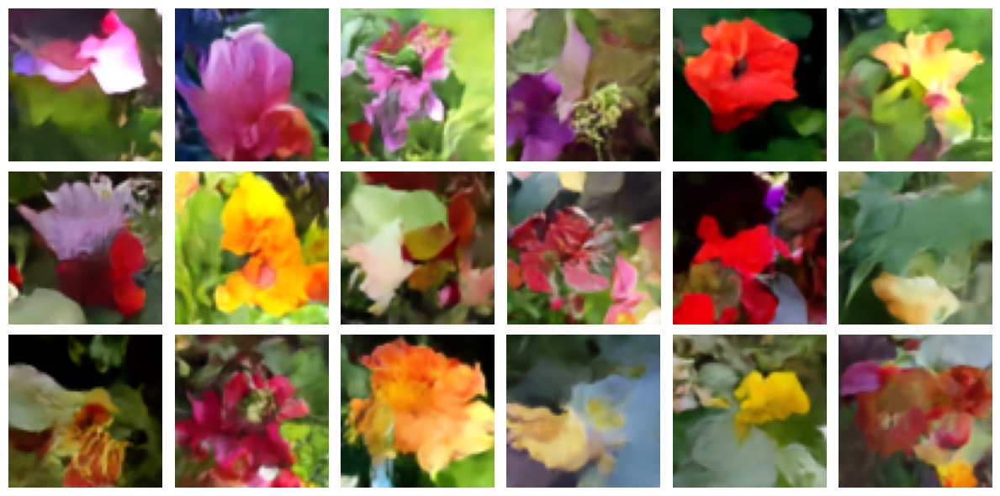

511/511 ━━━━━━━━━━━━━━━━━━━━ 162s 253ms/step - i_loss: 0.2416 - n_loss: 0.1496 - val_i_loss: 0.2340 - val_kid: 0.3045 - val_n_loss: 0.1449
Epoch 16/20
511/511 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step - i_loss: 0.2420 - n_loss: 0.1475

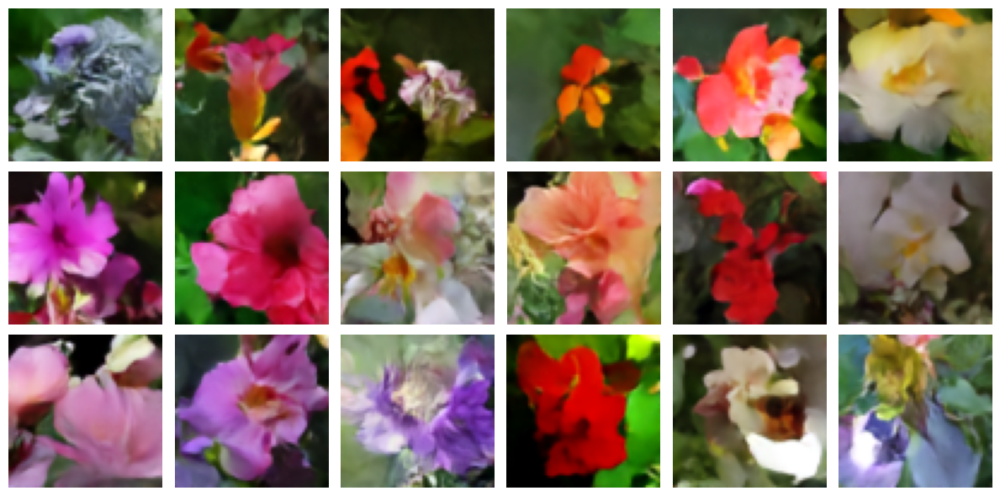

511/511 ━━━━━━━━━━━━━━━━━━━━ 172s 336ms/step - i_loss: 0.2420 - n_loss: 0.1475 - val_i_loss: 0.2345 - val_kid: 0.2894 - val_n_loss: 0.1433
Epoch 17/20
511/511 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step - i_loss: 0.2445 - n_loss: 0.1470

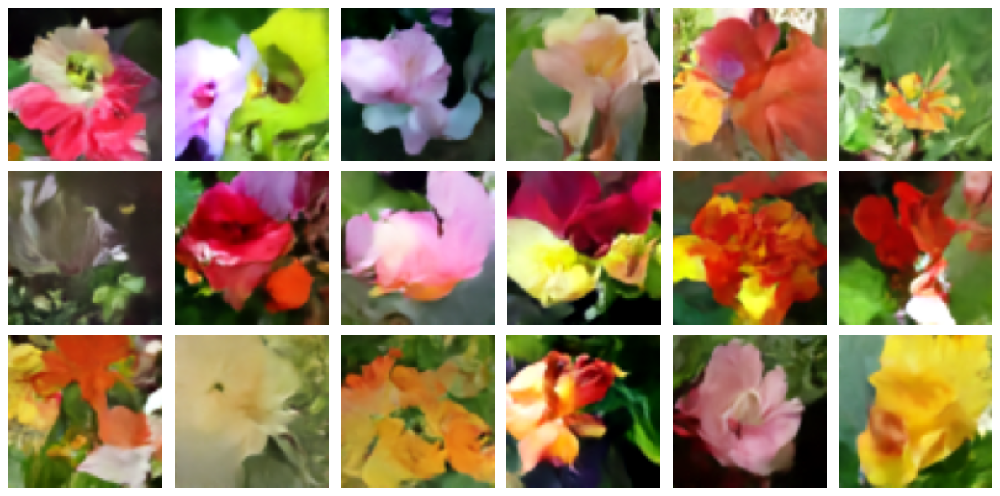

511/511 ━━━━━━━━━━━━━━━━━━━━ 159s 253ms/step - i_loss: 0.2445 - n_loss: 0.1470 - val_i_loss: 0.2342 - val_kid: 0.2753 - val_n_loss: 0.1436
Epoch 18/20
511/511 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step - i_loss: 0.2402 - n_loss: 0.1475

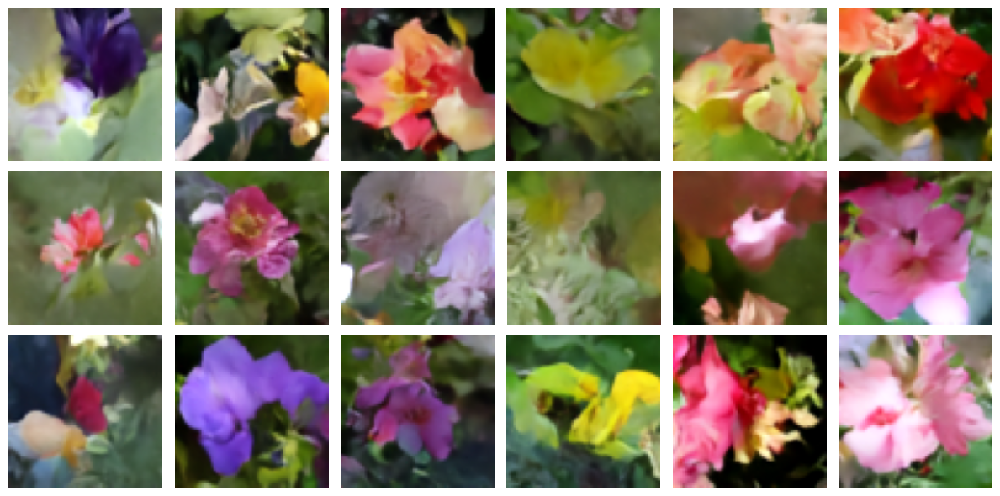

511/511 ━━━━━━━━━━━━━━━━━━━━ 184s 335ms/step - i_loss: 0.2402 - n_loss: 0.1475 - val_i_loss: 0.2338 - val_kid: 0.2624 - val_n_loss: 0.1431
Epoch 19/20
511/511 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step - i_loss: 0.2418 - n_loss: 0.1466

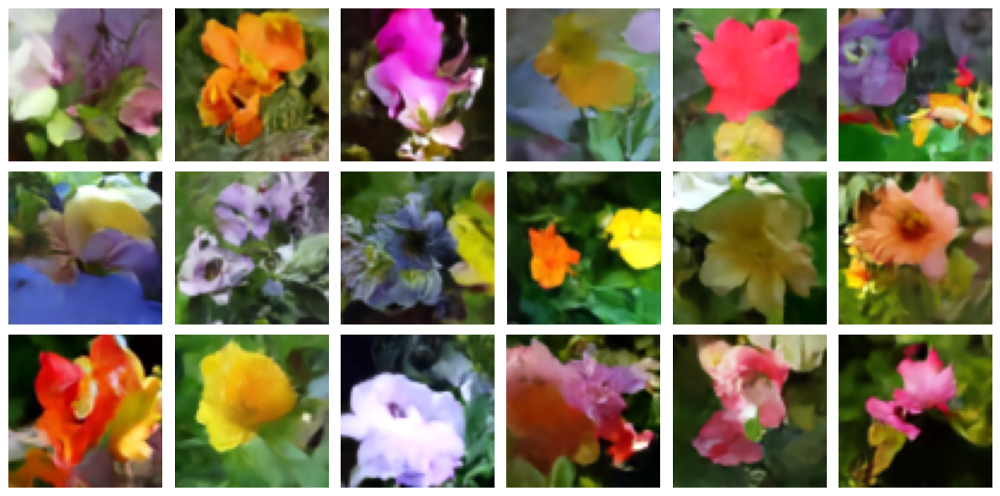

511/511 ━━━━━━━━━━━━━━━━━━━━ 130s 255ms/step - i_loss: 0.2418 - n_loss: 0.1466 - val_i_loss: 0.2332 - val_kid: 0.2593 - val_n_loss: 0.1440
Epoch 20/20
511/511 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step - i_loss: 0.2394 - n_loss: 0.1464

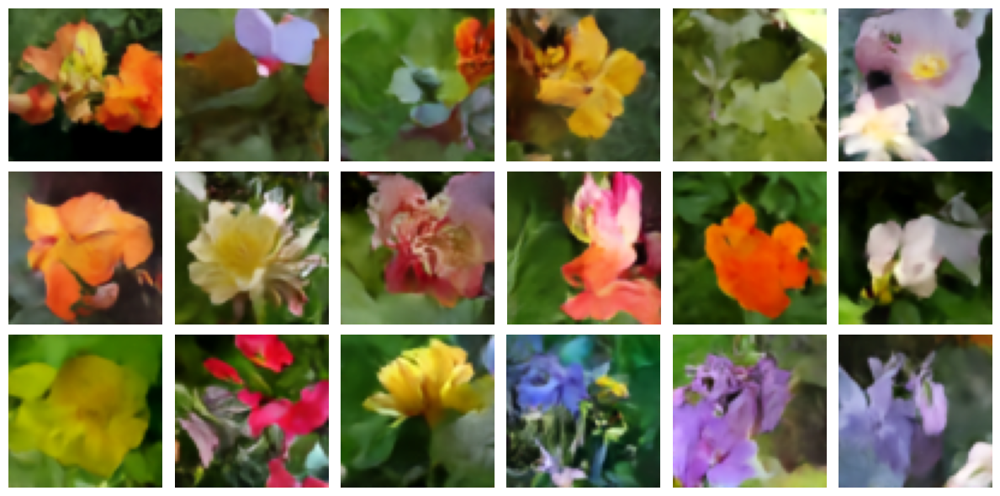

511/511 ━━━━━━━━━━━━━━━━━━━━ 143s 257ms/step - i_loss: 0.2394 - n_loss: 0.1464 - val_i_loss: 0.2312 - val_kid: 0.2501 - val_n_loss: 0.1437


In [ ]:
model = DiffusionModel(image_size, widths, block_depth)

model.compile(
    optimizer=keras.optimizers.AdamW(
        learning_rate=learning_rate, weight_decay=weight_decay
    ),
    loss=keras.losses.mean_absolute_error,
)

checkpoint_path = "checkpoints/diffusion_model.weights.h5"
checkpoint_callback = keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path,
    save_weights_only=True,
    monitor="val_kid",
    mode="min",
    save_best_only=True,
)

model.normalizer.adapt(train_dataset)

model.fit(
    train_dataset,
    epochs=num_epochs,
    validation_data=val_dataset,
    callbacks=[
        keras.callbacks.LambdaCallback(on_epoch_end=model.plot_images),
        checkpoint_callback,
    ],
)

In [ ]:
model.load_weights(checkpoint_path)
model.plot_images()

In [ ]:
import torch
import torch.nn as nn

# Lineárisan növekvő beták (alternatívaként lehet cosine schedule-t is használni)
def get_beta_schedule(beta_start, beta_end, timesteps):
    return torch.linspace(beta_start, beta_end, timesteps)

# Hyperparaméterek
timesteps = 1000
beta_start = 1e-4
beta_end = 2e-2
betas = get_beta_schedule(beta_start, beta_end, timesteps)

# Pre-számítások a diffúziós folyamat gyorsítására
alphas = 1.0 - betas
alphas_cumprod = torch.cumprod(alphas, dim=0)
alphas_cumprod_prev = torch.cat([torch.tensor([1.0]), alphas_cumprod[:-1]])

sqrt_alphas_cumprod = torch.sqrt(alphas_cumprod)
sqrt_one_minus_alphas_cumprod = torch.sqrt(1 - alphas_cumprod)
log_one_minus_alphas_cumprod = torch.log(1 - alphas_cumprod)
posterior_variance = betas * (1 - alphas_cumprod_prev) / (1 - alphas_cumprod)

In [ ]:
class SimpleUNet(nn.Module):
    def __init__(self, in_channels, out_channels, time_embed_dim):
        super(SimpleUNet, self).__init__()
        self.conv1 = nn.Conv2d(in_channels, 64, 3, padding=1)
        self.conv2 = nn.Conv2d(64, 128, 3, padding=1)
        self.conv3 = nn.Conv2d(128, 256, 3, padding=1)
        self.deconv1 = nn.ConvTranspose2d(256, 128, 3, padding=1)
        self.deconv2 = nn.ConvTranspose2d(128, 64, 3, padding=1)
        self.deconv3 = nn.ConvTranspose2d(64, out_channels, 3, padding=1)
        self.time_embed = nn.Linear(1, in_channels)  # Illesszük az időbeágyazást a bemeneti csatornákhoz
        self.relu = nn.ReLU()

    def forward(self, x, t):
        # Időlépés beágyazása és újraméretezése
        t_emb = self.relu(self.time_embed(t.unsqueeze(-1)))  # [batch_size, in_channels]
        t_emb = t_emb.view(t_emb.size(0), t_emb.size(1), 1, 1)  # [batch_size, in_channels, 1, 1]

        # Az időlépés hozzáadása a bemeneti képhez
        x = x + t_emb

        # UNet forward pass
        x = self.relu(self.conv1(x))
        x = self.relu(self.conv2(x))
        x = self.relu(self.conv3(x))
        x = self.relu(self.deconv1(x))
        x = self.relu(self.deconv2(x))
        x = self.deconv3(x)
        return x

In [ ]:
def compute_loss(model, x_0, t, noise):
    # x_t generálása az x_0-ból és zajból
    sqrt_alpha_t = sqrt_alphas_cumprod[t.long()].view(-1, 1, 1, 1)  # Újraméretezés
    sqrt_one_minus_alpha_t = sqrt_one_minus_alphas_cumprod[t.long()].view(-1, 1, 1, 1)  # Újraméretezés
    x_t = sqrt_alpha_t * x_0 + sqrt_one_minus_alpha_t * noise

    # t konvertálása float típusra a modell számára
    t = t.float()  # Ez elengedhetetlen, ha t bemeneti paraméter

    # Modell predikciója
    predicted_noise = model(x_t, t)

    # Mean Squared Error (MSE) loss
    loss = nn.MSELoss()(predicted_noise, noise)
    return loss

In [ ]:
# Modell és optimizáló mentése
def save_checkpoint(model, optimizer, epoch, loss, path):
    checkpoint = {
        'epoch': epoch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'loss': loss
    }
    torch.save(checkpoint, path)
    print(f'Checkpoint saved to {path}')

In [ ]:
# Modell és optimizáló betöltése
def load_checkpoint(model, optimizer, path):
    checkpoint = torch.load(path)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    epoch = checkpoint['epoch']
    loss = checkpoint['loss']
    print(f'Checkpoint loaded from {path}')
    return model, optimizer, epoch, loss

In [ ]:
# Optimizer
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# Ha van korábbi checkpoint, betöltjük
model = SimpleUNet(in_channels=3, out_channels=3, time_embed_dim=64).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=2e-4)

# Ha van checkpoint fájl, betöltjük
checkpoint_path = 'model_checkpoint.ckpt'
if os.path.exists(checkpoint_path):
    model, optimizer, start_epoch, _ = load_checkpoint(model, optimizer, checkpoint_path)
else:
    start_epoch = 0

# Pre-számítások
alphas_cumprod = alphas_cumprod.to(device)
sqrt_alphas_cumprod = sqrt_alphas_cumprod.to(device)
sqrt_one_minus_alphas_cumprod = sqrt_one_minus_alphas_cumprod.to(device)
log_one_minus_alphas_cumprod = log_one_minus_alphas_cumprod.to(device)
posterior_variance = posterior_variance.to(device)

# Training loop folytatása
for epoch in range(start_epoch, 150):  # Folytatjuk a tanítást az előző epoch számával
    for images, _ in small_train_loader:
        images = images.to(device)
        t = torch.randint(0, timesteps, (images.size(0),), device=device).long()
        noise = torch.randn_like(images)

        loss = compute_loss(model, images, t, noise)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    print(f"Epoch {epoch+1}, Loss: {loss.item()}")

    # Mentsd el a checkpointot minden egyes epoch végén
    save_checkpoint(model, optimizer, epoch, loss.item(), checkpoint_path)

In [ ]:
def plot_generated_images(images, num_images):
  # Csak az első `num_images` képet rajzoljuk ki
  images = images[:num_images].cpu().numpy()
  fig, axes = plt.subplots(4, 4, figsize=(8, 8))  # 4x4-es rács
  for i, ax in enumerate(axes.flatten()):
      if i >= num_images:
          break
      img = images[i].transpose(1, 2, 0)  # Csatorna átrendezése [C, H, W] -> [H, W, C]
      ax.imshow(img)
      ax.axis('off')
  plt.tight_layout()
  plt.show()

In [ ]:
T = 1000  # Definiáld az időlépések számát

# Képek generálása
generated_images = generate_images(model, num_images=16, img_size=(3, 64, 64), device=device)

# Képek kirajzolása
plot_generated_images(generated_images, num_images=16)